# Generating synthetic time-series single-cell datasets

This notebook explores the generation of synthetic time-series single-cell datasets, where temporal patterns are explicitly induced within distinct manifolds. It is divided into the following sections:
1. Collect the data and construct its lower-dimensional manifolds
2. Train the generative VAE-based models
3. Induce temporal transformations
4. Apply dimensionality reduction methods to the synthetic time-series data

(*) *Following all the steps in this notebook reproduces Figure 3 and Figure 4 in the Results section of the manuscript.*

In [3]:
using Pkg
Pkg.activate("../")

# Pkg.instantiate()

  Activating environment at `~/Documents/TimeSeries_project/scManifoldDynamics_test/Project.toml`


In [5]:
using CSV, DataFrames, VegaLite, Plots, Distributions, Random
using UMAP, TSne
using scVI  # Pkg.add(url="https://github.com/maren-ha/scVI.jl", rev="v0.1.0")
using Flux
using JLD2

include("../src/scManifoldDynamics.jl") # All the functions from the project are contained in a module called "scManifoldDynamics". 
using .scManifoldDynamics  # Import the module to access its functions.

In [3]:
# Create a directory to save the figures generated by this notebook
figures_path = joinpath(@__DIR__, "..", "figures/results/")

if !isdir(figures_path)
    mkdir(figures_path)
    println("Created folder: $figures_path")
else
    println("Folder already exists: $figures_path")
end

# If you want to save figures, use the following syntax with VegaLite:
# VegaLite.save(figures_path*"your_figure_name.svg"), your_plot_object)

Folder already exists: /Users/laiacanal/Documents/TimeSeries_project/scManifoldDynamics_test/Tutorial_notebooks/../figures/results/


### 1. Collect the data and construct its lower-dimensional manifolds

The raw data has been preprocessed using custom R scripts (available in this repository). Here, we will read the resulting preprocessed data directly from the Data folder using the `get_data` function. By default, this function stores parameter settings for the different dimensionality reduction methods as a dictionary within the returned AnnData object. If needed, you can override these defaults by providing custom parameter configurations.

The chosen classical dimensionality reduction methods used in this manuscript are PCA, t-SNE and UMAP. 
<div style="text-align: center;">
    <img src="../figures/dimred_methods.png" alt="Figure: Classical dimensionality reduction methods" width="1000" height="160"/>
</div>

In [6]:
picked_dataset = "Zeisel"
adata = get_data(picked_dataset)

AnnData object with a countmatrix with 2816 cells and 1000 genes
   unique celltypes: String31["interneurons", "pyramidal SS", "pyramidal CA1", "oligodendrocytes", "microglia", "endothelial-mural", "astrocytes_ependymal"]


In [7]:
df_reduced_dimensions, plot_reduced_dimensions = get_reduced_dimensions(adata)

# Uncomment if you want to see the coordinates of the first 5 points of each method. 
# grouped = groupby(df_reduced_dimensions, :Method)

# for (name, group) in pairs(grouped)
#     display(group[1:5, :])  
# end

(8448×4 DataFrame
  Row │ z1         z2         Celltype           Method 
      │ Float64    Float64    String31           String 
──────┼─────────────────────────────────────────────────
    1 │ -11.793     1.69135   interneurons       PCS
    2 │ -11.7737   -0.704458  interneurons       PCS
    3 │ -12.7738   -0.253366  interneurons       PCS
    4 │ -13.2982   -1.43572   interneurons       PCS
    5 │ -15.0728    1.03921   interneurons       PCS
    6 │ -12.908     2.8109    interneurons       PCS
    7 │ -13.1165    5.075     interneurons       PCS
    8 │ -12.6674    3.84213   interneurons       PCS
  ⋮   │     ⋮          ⋮              ⋮            ⋮
 8442 │   1.25476  -0.569977  endothelial-mural  UMAP
 8443 │   1.43218   6.03614   endothelial-mural  UMAP
 8444 │   1.90868   7.83892   endothelial-mural  UMAP
 8445 │  -2.32386   2.97774   endothelial-mural  UMAP
 8446 │  -2.79794   3.59157   endothelial-mural  UMAP
 8447 │  -2.39561   2.85946   endothelial-mural  UMAP
 8448 │  -

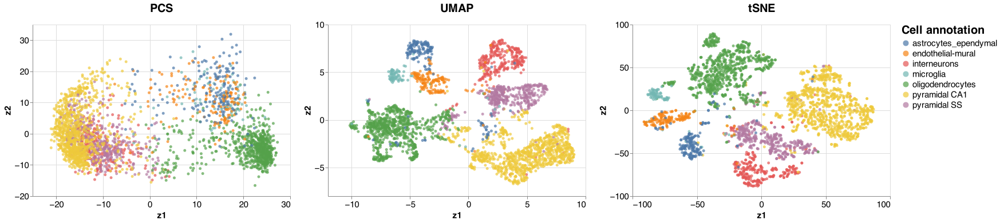

In [8]:
plot_reduced_dimensions

### 2. Train the generative VAE-based models

We use a Variational Autoencoder (VAE) as a generative model to learn a latent space that approximates the manifold observed by previous classical methods. At the same time, this model can generate new data from that latent space, which is useful for our purpose of creating synthetic time-series datasets. More specifically, we employ scVI, a VAE designed for single-cell data. This model was introduced in ["Deep generative modeling for single-cell transcriptomics"](https://www.nature.com/articles/s41592-018-0229-2) , and here we use its Julia implementation, publicly available in https://github.com/maren-ha/scVI.jl .  Because scVI is often used to obtain a visual representation of the data, we also include its manifold in our set of dimensional reduction methods.

In the cells below, we have two training options:<br>
2.1. Train scVI<br>
2.2. Train the supervised scVI


Both approaches produce the following outputs that can be stored in the Data folder:

- **trained_model**: Stores the neural network's learned weights, allowing future reuse without retraining.
- **trained_data**: Holds the data for further analysis, including:
  - A matrix of the latent representations,
  - A matrix of generated data in the original high-dimensional space
  - The original labels (in a supervised vae scenario).

### 2.1 Train scVI

In [10]:
choice_get_model = "train" #options are : "load" and "train" 
picked_model = "scvi"
if choice_get_model == "train"
    m_scvi = get_scvi_model(adata, 3841)
    latent_data = get_latent_representation(m_scvi, adata.countmatrix)
    generated_data = decodefromlatent(m_scvi, latent_data, adata.countmatrix)
    latent_from_generated = get_latent_representation(m_scvi, generated_data)
    # save_trained_model("§(picked_dataset)", "scvi", m_scvi, latent_data, generated_data)   # uncomment this line if you want to save the trained model
elseif choice_get_model == "load"
    m_scvi, trained_data = load_trained_model(picked_dataset, picked_model)
    latent_data = trained_data["latent"]
    latent_from_generated = get_latent_representation(m_scvi, Float32.(trained_data["generated"]))
end

┌ Info: Starting training for 200 epochs...
└ @ scVI /Users/laiacanal/.julia/packages/scVI/80WMK/src/Training.jl:121
Progress:   0%|                                         |  ETA: 14:50:16
Progress:   0%|▏                                        |  ETA: 2:10:10
Progress:   0%|▎                                        |  ETA: 1:27:21
Progress:   1%|▎                                        |  ETA: 1:22:27
Progress:   1%|▎                                        |  ETA: 1:10:55
Progress:   1%|▎                                        |  ETA: 1:02:15
Progress:   1%|▍                                        |  ETA: 0:55:30
Progress:   1%|▍                                        |  ETA: 0:50:06
Progress:   1%|▍                                        |  ETA: 0:45:41
Progress:   1%|▌                                        |  ETA: 0:43:10
Progress:   1%|▌                                        |  ETA: 0:40:46
Progress:   1%|▌                                        |  ETA: 0:37:55
Progress:   1%|▌  

2×2816 Matrix{Float32}:
 -1.52356  -1.51154   -2.15931   …  1.34325    0.982772    1.80771
  0.12235  -0.063811   0.316835     0.278251  -0.00731437  0.726112

In [11]:
# Create a Dataframe with the trained data for plotting (it is easier for VegaLite to plot with dataframe objects)
data_types = ["latent", "latent from generated"]
z1 = Float64[]
z2 = Float64[]
celltypes = String[]
data_type_labels = String[]


for data_type in data_types
    if data_type == "latent"
        data = latent_data
    else
        data = latent_from_generated
    end

    append!(z1, data[1,:])
    append!(z2, data[2,:])
    append!(celltypes, get_celltypes(adata))
    append!(data_type_labels, fill(data_type, size(data, 2)))
end

df_trained_data = DataFrame(z1 = z1, z2 = z2, Celltype = celltypes, DataType = data_type_labels);

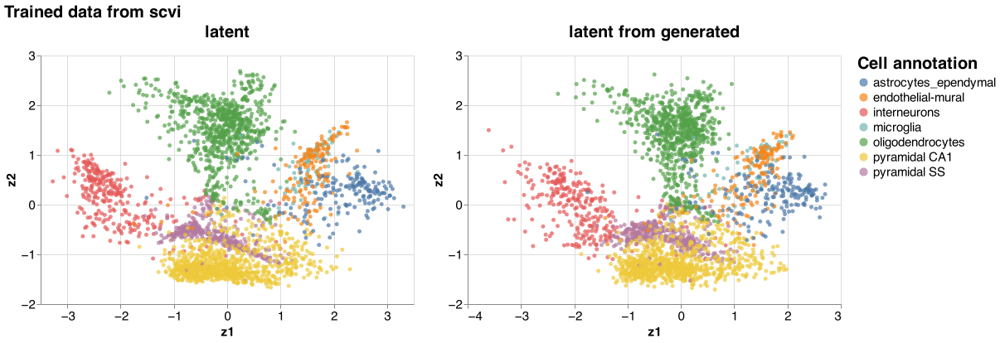

In [12]:
plot_reduced = df_trained_data |>
    @vlplot(title={"text"="Trained data from $(picked_model)", "fontSize"=20},
    width=450,
    height=300,
    :circle, 
    x={:z1, title="z1", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
    y={:z2, title="z2", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
    column = {"DataType:n", header={title = nothing, labelFontSize=20, titleFontSize=15, labelFontWeight="bold"}},
    color={"Celltype:n", scale={scheme="tableau10"}, legend={disable=false, title="Cell annotation",orient="right"}},
    size={value=25},
    config={legend={titleFontSize=20, labelFontSize=15}},
    resolve={scale={x="independent",y="independent"}}
)

### 2.2 Train Supervised VAE


In [13]:
# !! `m_sae` stores the trained or loaded model for supervised UMAP, supervised PCA, or supervised t-SNE. 
# If you want the supervised VAE to mimic another manifold (e.g., switching from supervised UMAP to supervised PCA), rerun this cell with the corresponding variables updated accordingly. 

choice_get_model = "train" # Options: "load" and "train"

picked_model = "umap_sae" # Options: pca_sae, tsne_sae, umap_sae
reference_model = "UMAP" # Options: PCS, tSNE, UMAP

if choice_get_model == "train"
    original_labels = Array(filter(row -> row.Method == "$(reference_model)", df_reduced_dimensions)[:,:1:2])' # The original_labels correspond to the points in the manifold found by each of the classical methods. 
    # We read this labels from the dataframe created at the beginning where we applied the 3 methods (PCA, tSNE and UMAP) to the data.
    m_sae = get_sae_model(adata, original_labels'; seed= 3841) # You will see the progress bar resets in the middle of the process. This is normal, as in this case, encoder and decoder are trained separately.
    latent_data = get_latent_representation(m_sae, adata.countmatrix)
    generated_data = decodefromlatent(m_sae, latent_data, adata.countmatrix)
    latent_from_generated = get_latent_representation(m_sae, generated_data)
    # save_trained_model("$(picked_dataset)", picked_model, m_sae, latent_data, generated_data; original_labels = original_labels)   # uncomment this line if you want to save the trained model
elseif choice_get_model == "load"
    m_sae, trained_data = load_trained_model(picked_dataset, picked_model)
    original_labels = trained_data["original_labels"]
    latent_data = trained_data["latent"]
    generated_data = Float32.(trained_data["generated"])
    latent_from_generated = get_latent_representation(m_sae, generated_data)
end

Progress:   0%|                                         |  ETA: 0:36:08
Progress:   1%|▎                                        |  ETA: 0:03:07
Progress:   1%|▌                                        |  ETA: 0:01:34
Progress:   2%|▊                                        |  ETA: 0:01:06
Progress:   3%|█▏                                       |  ETA: 0:00:53
Progress:   3%|█▍                                       |  ETA: 0:00:43
Progress:   4%|█▊                                       |  ETA: 0:00:37
Progress:   5%|██                                       |  ETA: 0:00:34
Progress:   6%|██▎                                      |  ETA: 0:00:31
Progress:   6%|██▋                                      |  ETA: 0:00:28
Progress:   7%|███                                      |  ETA: 0:00:26
Progress:   8%|███▎                                     |  ETA: 0:00:25
Progress:   9%|███▋                                     |  ETA: 0:00:23
Progress:  10%|████                                     |  ETA: 

2×2816 Matrix{Float32}:
 3.5272   3.17038  2.81243  2.85951  3.03782  …  -2.93609  -3.64971  -3.40412
 6.39854  9.03921  5.60071  7.7368   5.04518      3.73907   3.32114   5.28343

In [14]:
# Again, we create a dataframe with the trained data for plotting. In this case we have to add the "original labels" so we can see if the latent representation of the data found by the supervised VAE is consistent
# with the reference points found by the classical models the supervised VAE tries to mimic. 
data_types = ["original_labels", "latent", "generated"]
z1 = Float64[]
z2 = Float64[]
celltypes = String[]
data_type_labels = String[]


for data_type in data_types
    if data_type == "original_labels"
        data = original_labels
    elseif data_type == "latent"
        data = latent_data
    elseif data_type == "generated"
        data = latent_from_generated
    end

    append!(z1, data[1,:])
    append!(z2, data[2,:])
    append!(celltypes, adata.celltypes)
    append!(data_type_labels, fill(data_type, size(data, 2)))
end

df_trained_data = DataFrame(z1 = z1, z2 = z2, Celltype = celltypes, DataType = data_type_labels);

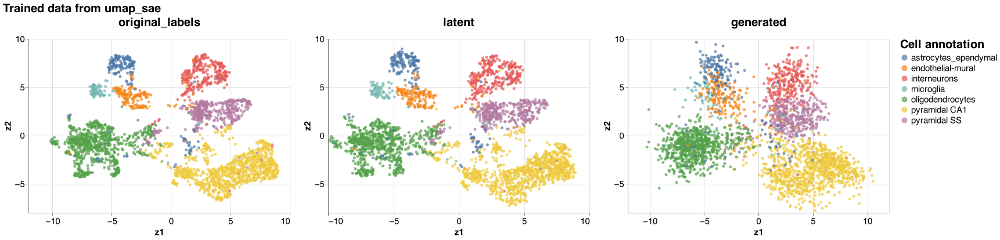

In [15]:
plot_reduced = df_trained_data |>
    @vlplot(title={"text"="Trained data from $(picked_model)", "fontSize"=20},
    width=450,
    height=300,
    :circle, 
    x={:z1, title="z1", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
    y={:z2, title="z2", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
    column = {"DataType:n", header={title = nothing, labelFontSize=20, titleFontSize=15, labelFontWeight="bold"}, sort=["original_labels", "latent", "generated"]},
    color={"Celltype:n", scale={scheme="tableau10"}, legend={disable=false, title="Cell annotation",orient="right"}},
    size={value=25},
    config={legend={titleFontSize=20, labelFontSize=15}},
    resolve={scale={x="independent",y="independent"}}
)

### 3. Induce temporal transformations


During the following procedure, several variables are introduced. If at some point you are unsure about the meaning of any variable, refer to the following figure for clarification:

<div style="text-align: center;">
    <img src="../figures/figure_variables_model.png" alt="Figure: Variables Model" width="1000" height="500"/>
</div>

Moreover, additional details on how the transformations in the latent space are performed can be found in the `transformations.ipynb` notebook.


In [16]:
picked_model = "umap_sae" # we will copy in "m" the model we want to use (here, put scvi for the scvi or the corresponding name for the supervised VAE)
m = deepcopy(picked_model == "scvi" ? m_scvi : m_sae) 

scVAE(1000, 1, 128, 2, 1, :gene, 0.1f0, false, :zinb, :normal, nothing, nothing, true, Dict{Any, Any}(), true, scEncoder(Chain(Dense(1000, 128), BatchNorm(128), identity, #43, Dropout(0.1)), Dense(128, 2), 1000, 2, 128, 1, exp, Dense(128, 2), 0.0001f0, identity), nothing, scDecoder(2, 128, 1000, 1, Chain(Dense(2, 128), BatchNorm(128), identity, #43, Dropout(0.1)), Dense(128, 1000), Float32[1.2942274, 0.26874465, 0.20788386, -0.04999767, 1.2712305, 0.82868326, 0.16319764, 1.0488857, 0.57308763, 1.1332598  …  1.6009881, 1.5090626, 1.7247616, 1.2450145, 0.92786217, 1.3235888, 0.88066316, 0.11417016, 1.3262151, -0.8380153], Chain(Dense(128, 1000), #62), true, false))

In [17]:
ncells, ngenes = size(adata.countmatrix)
ntimepoints = 4
zdim = 2 
# Observation: It is possible to retrieve the latent and generated data or create them again using the encoder and decoder of the model m. 
# lowdata = latent_data 
lowdata = get_latent_representation(m, adata.countmatrix)'

latent_transformed_data = fill(0.0f0, size(lowdata, 1), zdim, ntimepoints) 
latent_transformed_data[:,:,1] = lowdata # at timepoint 1 we have the original data

generated_transformed_data = fill(0.0f0, size(lowdata, 1), ngenes, ntimepoints) 
# generated_transformed_data[:,:,1] = generated_data
generated_transformed_data[:,:,1] = decodefromlatent(m, lowdata', adata.countmatrix) 

2816×1000 Matrix{Float32}:
  0.0   0.0  0.0   0.0  0.0  0.0  3.0  …   1.0   5.0  0.0  2.0   2.0   0.0
  0.0   0.0  0.0   0.0  0.0  0.0  0.0      4.0   0.0  4.0  1.0   3.0  11.0
 24.0   0.0  0.0   0.0  0.0  0.0  2.0      6.0   5.0  4.0  4.0   4.0   1.0
  0.0   0.0  0.0   0.0  0.0  0.0  0.0      3.0  10.0  3.0  8.0   6.0   0.0
  0.0   0.0  0.0   0.0  0.0  0.0  2.0      2.0   7.0  2.0  0.0   0.0   2.0
  0.0   0.0  0.0   0.0  0.0  0.0  0.0  …   1.0  10.0  6.0  0.0   2.0   2.0
  0.0   0.0  2.0  11.0  0.0  0.0  1.0      5.0   8.0  0.0  0.0  10.0   1.0
  0.0   0.0  0.0   0.0  0.0  0.0  0.0      2.0   3.0  2.0  1.0   4.0   2.0
  5.0   0.0  0.0   0.0  0.0  0.0  0.0      7.0   4.0  8.0  1.0   1.0   3.0
  0.0   0.0  6.0   0.0  0.0  2.0  2.0     11.0  11.0  1.0  1.0   1.0   2.0
  ⋮                          ⋮         ⋱         ⋮                    
  0.0   0.0  1.0   0.0  0.0  1.0  0.0      0.0   0.0  0.0  1.0   0.0   0.0
  6.0   0.0  0.0   0.0  0.0  0.0  0.0      0.0   0.0  1.0  1.0   2.0   0.0
  

We need to obtain the indices of each cluster to manipulate them manually. For practical reasons, we will refer to the clusters as `c1`, `c2`, and so on, instead of using the actual names of the cell types. The indices of the cells in each cluster are stored in the variable `c`, and you can access them using `c[1]`, for example, to get the indices of cluster 1. The correspondence between the cluster names/cell types and the cluster numbers can be found in the `combined_labels` variable.

By default, the function `find_clusters` will return the clusters based on the cell type annotation. If you want to create custom clusters based on specific criteria, you can use the `create_clusters` function. For more details, please refer to the function's documentation.


"7 different cell types have been found:"

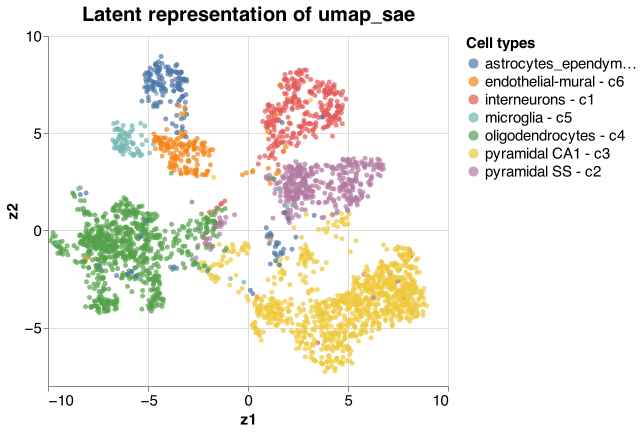

["interneurons - c1", "pyramidal SS - c2", "pyramidal CA1 - c3", "oligodendrocytes - c4", "microglia - c5", "endothelial-mural - c6", "astrocytes_ependymal - c7"]


In [18]:
c, combined_labels = find_clusters(adata)

ncelltypes = length(unique(c))

latent_plot = @vlplot(title={"text"="Latent representation of $(picked_model)", "fontSize"=20},
        width=400,
        height=350,
        :circle, 
        x={lowdata[:,1], title="z1", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
        y={lowdata[:,2], title="z2", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
        color={combined_labels, scale={scheme="tableau10"}, legend={disable=false, title="Cell types",orient="right"}},
        size={value=25},
        config={title = {titlefontSize=40}, legend={titleFontSize=15, labelFontSize=15}},
        resolve={scale={x="independent",y="independent"}}
    )
display(latent_plot)
println(unique(combined_labels))

The following parameters were used to generate the transformations shown in Figures 3 and 4 of the manuscript. Please note that achieving complete reproducibility across different operating systems can be challenging. The 2-dimensional representations of UMAP or t-SNE may differ slightly, and as a result, the parameter sets provided here might not perfectly reproduce the figures.

**Figure 3 (A)**: Transformation in a tSNE Space:
- **Cluster 1 transformation parameters:**
    - Separation line: `m = 6`, `n = 80`, `sigma = 30`
    - **Function above:**
        - `α = -π/6`, `cx = -75`, `cy = 0`, `xpush_a = 150`, `xpush_b = 125`
    - **Function below:**
        - `α = π/16`, `cx = 0`, `cy = 50`, `xmoveto = 50`, `ymoveto = -200`, `xmoveto_steps = -7`, `ymoveto_steps = 8`

**Figure 3 (C)**: Transformation in a UMAP Space:
- **Cluster 1 transformation parameters:**
    - Separation line: `m = -5/2`, `n = 15/2`, `sigma = 3`
    - **Function above:**
        - `α = -π/32`, `xmoveto = 18`, `xmoveto_steps = 10`, `ymoveto = 12`, `ymoveto_steps = 8`
    - **Function below:**
        - `α = π/32`, `xlinshift = -1`, `xmoveto = -11`, `xmoveto_steps = -10`

**Figure 4 (A)**: Transformation in a UMAP Space:
- **Cluster 5 transformation parameters:**
    - `α = -π/22`
- **Cluster 6 transformation parameters:**
    - `α = π/10`, `cx = -10`, `cy = 0`, `xlinshift = 0.5`, `ylinshift = 1`, `ypush_a = 7`, `ypush_b = -8`

**Figure 4 (C)**: Transformation in a UMAP Space:
- **Cluster 1 transformation parameters:**
    - `α = -π/6`, `cx = 12`, `cy = -10`, `ypush_a = 30`, `ypush_b = -18`, `xlinshift = -3`, `ylinshift = 2`
- **Cluster 6 transformation parameters:**
    - `α = -π/16`, `xmoveto = -12`, `ymoveto = -19`, `xmoveto_steps = 6`, `ymoveto_steps = 6`


The code provided below outlines how to reproduce Figure 4 (A), but the same procedure can be applied to the rest of the figures by adjusting the corresponding parameters.


In [21]:
# 1. We select the indices of the clusters we want to change
ind_clusterchange = [5,6] 
vec_clusterchange = [c[ind_clusterchange[1]]] 

# 2. We initialize a vector f to store the transformation functions for each cluster (e.g., f[1] stores the function that we aim to use to transform cluster 1).
f = Vector{FunctionParams}(undef, ncelltypes)

# There are three types of `FunctionParams` objects: `fgeneral_transformation`, `divide_cluster`, and `fdivide_continuous`. For details, we refer to the transformations notebook. 

# The key point is that when defining a `FunctionParams`, we must specify the type and the corresponding parameters, as FunctionParams follows the following structure:
# mutable struct FunctionParams{T, P}
#   tfunction::T
#   params::P
# end

# Some examples are displayed below.  

#3. For each cluster to be modified, we define a transformation. 

# ---------- Figure 4A ----------
f[5] = FunctionParams(fgeneral_transformation, (α = -pi/22,))
f[6] = FunctionParams(fgeneral_transformation, (α = pi/10, cx=-10, cy=0, xlinshift=0.5, ylinshift=1, ypush_a=7, ypush_b=-8))

# ---------- Figure 3A ---------- (this is an exemplary example of the code, this figure is with done with the PMBC and needs ind_clusterchange = [1])
# In this Figure, cluster 1 is divided, with points above the line following the function fa and those below following fb.
# fa = FunctionParams(fgeneral_transformation, (α = -pi/32, xmoveto = 18, xmoveto_steps = 10, ymoveto = 12, ymoveto_steps = 8 )) 
# fb = FunctionParams(fgeneral_transformation, (α = pi/32, xlinshift = -1, xmoveto = -11, xmoveto_steps = -10)) 
# f[1] = FunctionParams(divide_cluster, (m=-5/2, n=15/2, fa=fa, fb=fb, sigma=3,))



FunctionParams{typeof(fgeneral_transformation), NamedTuple{(:α, :cx, :cy, :xlinshift, :ylinshift, :ypush_a, :ypush_b), Tuple{Float64, Int64, Int64, Float64, Int64, Int64, Int64}}}(Main.scManifoldDynamics.fgeneral_transformation, (α = 0.3141592653589793, cx = -10, cy = 0, xlinshift = 0.5, ylinshift = 1, ypush_a = 7, ypush_b = -8))

In [22]:
# transf_seed = 1234 # uncomment if you want always the same noise pattern
for tp in 2:ntimepoints
    for ct in ind_clusterchange
        latent_transformed_data[c[ct],:,tp] = Vector_Field(latent_transformed_data[c[ct],:,tp-1], f[ct])  
        vec_clusterchange = union(vec_clusterchange, c[ct])
    end
    σ = 0.2 # we recommend to use σ = 0.8 in pca_sae, since the points are spread over a larger range
    g = Normal(0, σ)
    re_lowdata = lowdata[setdiff(1:end, vec_clusterchange),:] # rest of the lowdata
    # Random.seed!(transf_seed)
    latent_transformed_data[setdiff(1:end, vec_clusterchange),:,tp] = re_lowdata .+ rand(g,size(re_lowdata,1), size(re_lowdata,2))  
    generated_transformed_data[:,:,tp] = decodefromlatent(m, latent_transformed_data[:,:,tp]', adata.countmatrix)
end

Once the transformation is applied we collect all the transformed data into the following two objects:
- `tf_data`: High dimensional synthetic time-series single-cell data. This is the data we will use in point 4 for testing the methods on. 
- `latent_tf_data`: The original latent transformation. It will be used as a benchmark for comparing how the methods capture the real transformation.

In [2]:
tf_data = cat(collect(generated_transformed_data[:,:, tp] for tp in 1:ntimepoints)..., dims=1)
latent_tf_data = cat(collect(latent_transformed_data[:,:, tp] for tp in 1:ntimepoints)..., dims=1)


df_scatter_transformed = DataFrames.DataFrame(z1 = latent_tf_data[:,1], 
                                        z2 = latent_tf_data[:,2], 
                                        timepoint = cat(collect(fill(i, size(latent_transformed_data[:,1,1], 1)) for i in 1:ntimepoints)..., dims=1),
                                        Celltype  = repeat(get_celltypes(adata), outer=ntimepoints), 
)


plot_transformed_data = df_scatter_transformed |>  
@vlplot(width=400,
        height=300,
        :circle, 
        x={:z1, title="z1", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
        y={:z2, title="z2", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
        column = {:"timepoint:n",  header={title = "Timepoint", labelFontSize=15, titleFontSize=15, labelFontWeight="bold"}}, 
        color={"Celltype:n", scale={scheme="tableau10"}, legend={disable=true, title="Clusters",orient="right"}},
        #color={:timepoint, legend={disable=false, title="Time",orient="right"}},
        size={value=30},
        labelFontSize=50,
        config={legend={titleFontSize=20, labelFontSize=20}}
)

UndefVarError: UndefVarError: ntimepoints not defined

In [73]:
# Save synthetic data 
transnum = "t1" # change the name each time following your mnemonic naming scheme
folder_syntheticdata = "../Data/Synthetic_data/$(picked_dataset)/$(picked_model)/"

if !isdir(folder_syntheticdata)
    mkpath(folder_syntheticdata)
    @info "Created directory: $folder_syntheticdata"
else
    @info "Directory already exists: $folder_syntheticdata"
end

control_file = folderdata*"$(transnum).png" # When having multiple transformations, the names can get messy. Ensure the data is not overwritten by checking if a file with the same transformation name already exists.
if !isfile(control_file)
    VegaLite.save(folderdata*"$(transnum).png", plot_transformed_data)
    VegaLite.save(folderdata*"$(transnum).pdf", plot_transformed_data)

    eval(Meta.parse("$(transnum) = Dict()"))
    eval(Meta.parse("$(transnum)[\"latent\"] = latent_tf_data"))
    eval(Meta.parse("$(transnum)[\"generated\"] = tf_data"))

    transformation_function = [] 
    for ct in ind_clusterchange
        info_cluster = "Cluster $(ct): " * params_information(f[ct])
        push!(transformation_function, info_cluster)
    end

    eval(Meta.parse("$(transnum)[\"transformation_info\"] = transformation_function"))
    eval(Meta.parse("$(transnum)[\"cluster_info\"] = c"))

    JLD2.save(folderdata*"matrices_$(transnum).jld2", "$(transnum)", eval(Symbol(transnum)))
    println("Transformation $(picked_dataset)/$(picked_model)/$(transnum) saved")
else
    println("Transformation $(picked_dataset)/$(picked_model)/$(transnum) not saved to avoid overwritting")
end

### 4. Apply dimensionality reduction methods to the synthetic time-series data

In this section, instead of using the `get_reduced_dimensions`from Section 1, we perform each dimensionality reduction step directly. This approach offers more freedom for trying different parameter settings for each method, allowing for deeper investigation of the methods behavior when dealing with time structure.

In [82]:
tf_adata = AnnData(countmatrix=tf_data, 
            celltypes = repeat(get_celltypes(adata), outer=ntimepoints),
            obs = DataFrame(timepoint =  cat(collect(fill(i, length(get_celltypes(adata))) for i in 1:ntimepoints)..., dims=1))
    )

AnnData object with a countmatrix with 29920 cells and 200 genes
   information about cells: 3×1 DataFrame
 Row │ timepoint
     │ Int64
─────┼───────────
   1 │         1
   2 │         1
   3 │         1
   unique celltypes: String15["B-cells", "CD4+ T-cells", "Monocytes", "CD8+ T-cells", "NK cells", "NA", "HSC", "Erythrocytes"]


In [83]:
if picked_dataset == "PBMC"
        big_TSNE_args = TSNEArgs(seed = 1013, perplexity = 200, pca_dims = 20)
        big_UMAP_args = UMAPArgs(seed = 87, pca_dims = 10) #105
elseif picked_dataset == "Zeisel"
        big_TSNE_args = TSNEArgs(seed = 1013, perplexity = 100, pca_dims = 20)
        big_UMAP_args = UMAPArgs(seed = 9711, pca_dims = 100)
end

UMAPArgs
  seed: Int64 87
  pca_dims: Int64 10
  min_dist: Float64 0.5


In [53]:
translognormcounts = log.(normalization(tf_data) .+ 1)  

pcs = scVI.prcomps(translognormcounts)

Random.seed!(big_TSNE_args.seed) 
tSNE = tsne(rescale(tf_data, dims=1), 2, big_TSNE_args.pca_dims, 1000, big_TSNE_args.perplexity, progress=true)

Random.seed!(big_UMAP_args.seed)
# umapout = umap(Transpose(translognormcounts), min_dist=0.5)
umapout = umap(pcs[:,1:big_UMAP_args.pca_dims]', min_dist=0.5) 


2×11264 Matrix{Float32}:
 5.38308  5.37954  5.33839  5.32652  5.21606  …  -2.51317  -2.99281  -1.24489
 9.11164  9.11102  8.65301  9.0522   8.82941     -3.40512  -3.14458  -4.48449

In [54]:
Random.seed!(3841)
library_log_means, library_log_vars = init_library_size(tf_adata) 

tf_m_scvi = scVAE(size(tf_adata.countmatrix,2);
            n_layers=1,
            n_latent=2,
            library_log_means=library_log_means,
            library_log_vars=library_log_vars
        )


training_args = TrainingArgs(
        train_test_split=false, 
        lr = 1e-3, #1e-3 for 10 dim
        batchsize=128, 
        max_epochs=200, # 50 for 10-dim 
        weight_decay=Float32(1e-6),
        register_losses = true,
        verbose=false
        )

train_model!(tf_m_scvi, tf_adata, training_args)

tf_latent_data = get_latent_representation(tf_m_scvi, tf_adata.countmatrix)



2×11264 Matrix{Float32}:
 -2.09794   -2.12421   -2.11018   …   1.44414    1.28083     1.29594
 -0.691788  -0.690728  -0.635503     -0.326472  -0.0823642  -0.47841

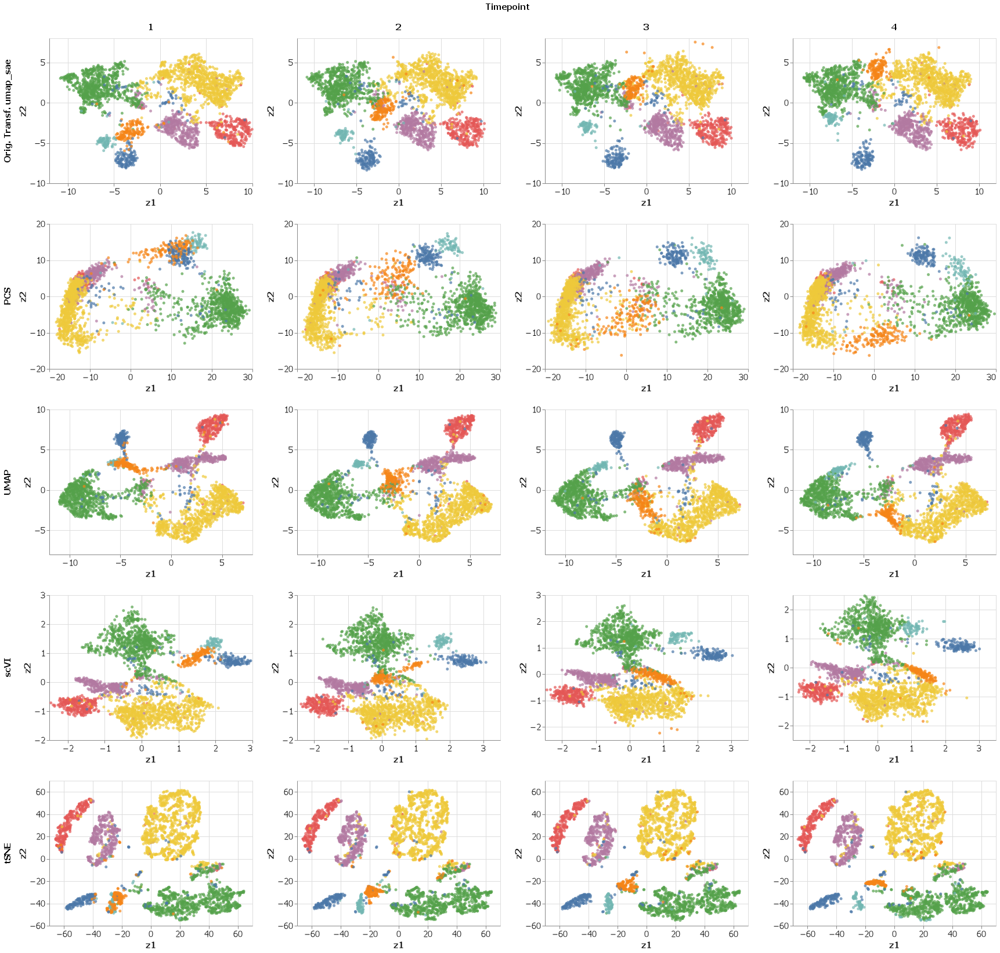

In [57]:
df_reduced_dimensions_tf_data = DataFrame(z1 = vcat(latent_tf_data[:,1], pcs[:,1], tSNE[:,1], umapout[1,:], tf_latent_data[1,:]), 
                        z2 = vcat(latent_tf_data[:,2], pcs[:,2], tSNE[:,2], umapout[2,:], tf_latent_data[2,:]),
                        Celltype = repeat(get_celltypes(tf_adata), outer = 5),
                        timepoint = repeat(tf_adata.obs.timepoint,  outer = 5),
                        Method = vcat(fill("Orig. Transf. $(picked_model)", scVI.ncells(tf_adata)), fill("PCS", scVI.ncells(tf_adata)), fill("tSNE", scVI.ncells(tf_adata)), fill("UMAP", scVI.ncells(tf_adata)), fill("scVI", scVI.ncells(tf_adata))), 
)


plot_reduced_dimensions_tf_data = df_reduced_dimensions_tf_data |>
@vlplot(width=350,
        height=250,
        :circle, 
        x={:z1, title="z1", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
        y={:z2, title="z2", axis={titleFontSize=15, labelFontSize=15, tickCount=5}}, 
        column = {"timepoint:n", header={title = "Timepoint", labelFontSize=15, titleFontSize=15, labelFontWeight="bold"}},
        row = {"Method:n", header={title = nothing, labelFontSize=15, titleFontSize=15, labelFontWeight="bold"}}, #sort=["Orig. Transf. $(picked_model)", "PCS, tSNE, UMAP, scVI"]
        color={"Celltype:n", scale={scheme="tableau10"}, legend={disable=true, title="Clusters",orient="right"}},
        #color={:timepoint, legend={disable=true, title="Clusters",orient="right"}},
        size={value=25},
        config={legend={titleFontSize=20, labelFontSize=15}},
        resolve={scale={x="independent",y="independent"}} 
)

In [ ]:
# Save the plots, optionally also the dataframe with the results. 

VegaLite.save(figurespath*"$(picked_dataset)/$(picked_model)/$(transnum).pdf", plot_reduced_dimensions_tf_data)
# VegaLite.save(figurespath*"(picked_dataset)/$(picked_model)/$(transnum).png", plot_reduced_dimensions_tf_data)

# CSV.write("../Data/Synthetic_data/$(picked_dataset)/$(picked_model)/$(transnum)_df_reduced_dimensions_tf_data.csv", df_reduced_dimensions_tf_data)

